### Notebook to transform raw counts and visualise marker genes in integrated manifold 

- **Developed by**: Carlos Talavera-López Ph.D
- **Würzburg Institute for Systems Immunology & Faculty of Medicine, Julius-Maximilian-Universität Würzburg**
- v230814

### Import required modules

In [31]:
import anndata
import numpy as np
import fastcluster
import pandas as pd
import scanpy as sc
import seaborn as sns
from pywaffle import Waffle
from bioservices import KEGG
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from scipy.spatial.distance import pdist
from scipy.cluster.hierarchy import linkage

### Set up working environment

In [2]:
sc.settings.verbosity = 3
sc.logging.print_versions()
sc.settings.set_figure_params(dpi = 180, color_map = 'magma', dpi_save = 300, vector_friendly = True, format = 'svg')

-----
anndata     0.9.2
scanpy      1.9.4
-----
PIL                 10.0.0
appdirs             1.4.4
asttokens           NA
attr                23.1.0
backcall            0.2.0
bioservices         1.11.2
bs4                 4.12.2
cattr               NA
cattrs              NA
certifi             2023.07.22
charset_normalizer  3.2.0
colorama            0.4.6
colorlog            NA
comm                0.1.4
cycler              0.10.0
cython_runtime      NA
dateutil            2.8.2
debugpy             1.6.7.post1
decorator           5.1.1
easydev             0.12.1
exceptiongroup      1.1.3
executing           1.2.0
h5py                3.9.0
idna                3.4
importlib_resources NA
ipykernel           6.25.1
ipywidgets          8.1.0
jedi                0.19.0
joblib              1.3.2
kiwisolver          1.4.5
llvmlite            0.40.1
lxml                4.9.3
matplotlib          3.7.2
mpl_toolkits        NA
natsort             8.4.0
numba               0.57.1
numpy             

### Read in Healthy-CTRL dataset

In [4]:
BrEpit_ALL = sc.read_h5ad('../data/Marburg_cell_states_locked_scANVI_ctl230901.raw.h5ad') 
BrEpit_ALL

AnnData object with n_obs × n_vars = 97573 × 27208
    obs: 'sex', 'age', 'ethnicity', 'PaCO2', 'donor', 'infection', 'disease', 'SMK', 'illumina_stimunr', 'bd_rhapsody', 'n_genes', 'doublet_scores', 'predicted_doublets', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'n_counts', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', 'condition', 'sample_group', 'IAV_score', 'group', 'Viral_score', 'cell_type', 'cell_states', 'leiden', 'cell_compartment', 'seed_labels', '_scvi_batch', '_scvi_labels', 'C_scANVI'
    var: 'mt', 'ribo'
    obsm: 'X_scANVI', 'X_scVI', 'X_umap'

### Visualise manifold with `scANVI` annotation

/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping prov

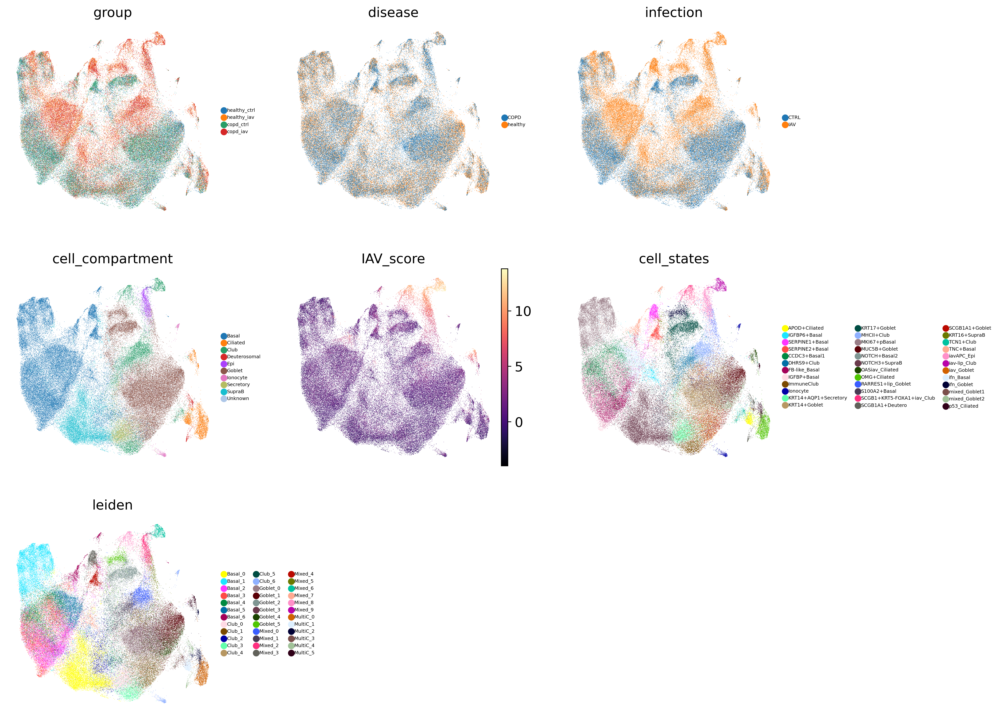

In [5]:
sc.pl.umap(BrEpit_ALL, frameon = False, color = ['group', 'disease', 'infection', 'cell_compartment', 'IAV_score', 'cell_states', 'leiden'], size = 0.6, legend_fontsize = 5, ncols = 3)

/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


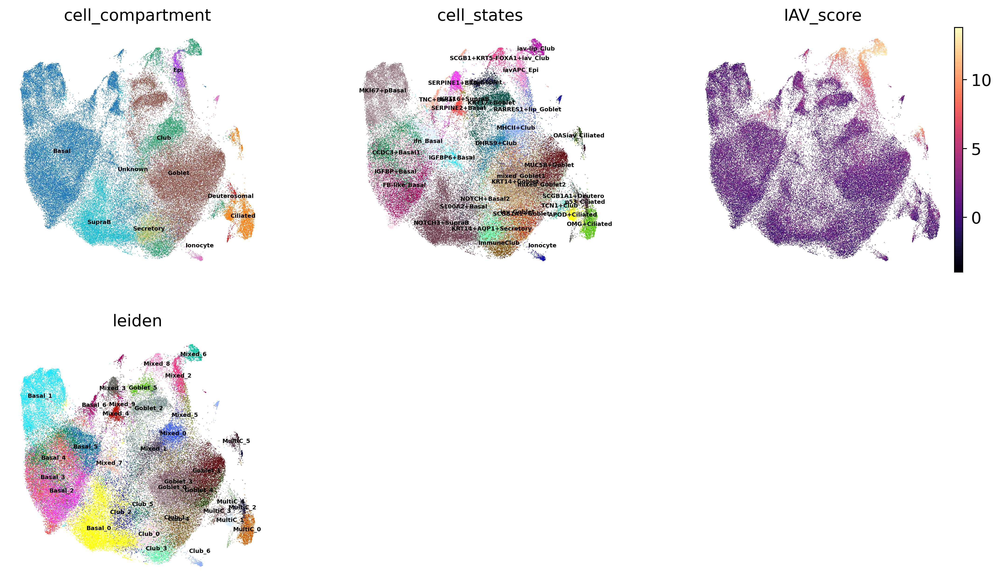

In [6]:
sc.pl.umap(BrEpit_ALL, frameon = False, color = ['cell_compartment', 'cell_states', 'IAV_score', 'leiden'], size = 1, legend_fontsize = 5, ncols = 3, legend_loc = 'on data', layer = 'sqrt_norm')

### Save object for visualisation with cellxgene

In [7]:
adata_log = anndata.AnnData(X = BrEpit_ALL.X,  var = BrEpit_ALL.var, obs = BrEpit_ALL.obs, obsm = BrEpit_ALL.obsm)
sc.pp.normalize_total(adata_log, target_sum = 1e6, exclude_highly_expressed = True)
sc.pp.log1p(adata_log)
adata_log.layers["sqrt_norm"] = np.sqrt(
    sc.pp.normalize_total(adata_log, inplace = False)["X"]
)

normalizing counts per cell The following highly-expressed genes are not considered during normalization factor computation:
['ACTB', 'BPIFA1', 'MALAT1', 'MT-ATP6', 'MT-CO1', 'MT-CO2', 'MT-CO3', 'MT-CYB', 'MT-ND1', 'MT-ND2', 'MT-ND3', 'MT-ND4', 'MT-ND5', 'MTRNR2L12', 'MTRNR2L8', 'NC_026431.1', 'NC_026432.1', 'NC_026433.1', 'NC_026434.1', 'NC_026435.1', 'NC_026436.1', 'NC_026437.1', 'NC_026438.1', 'SAA1', 'SCGB1A1', 'SCGB3A1', 'SLPI']
    finished (0:00:01)
normalizing counts per cell
    finished (0:00:01)


/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


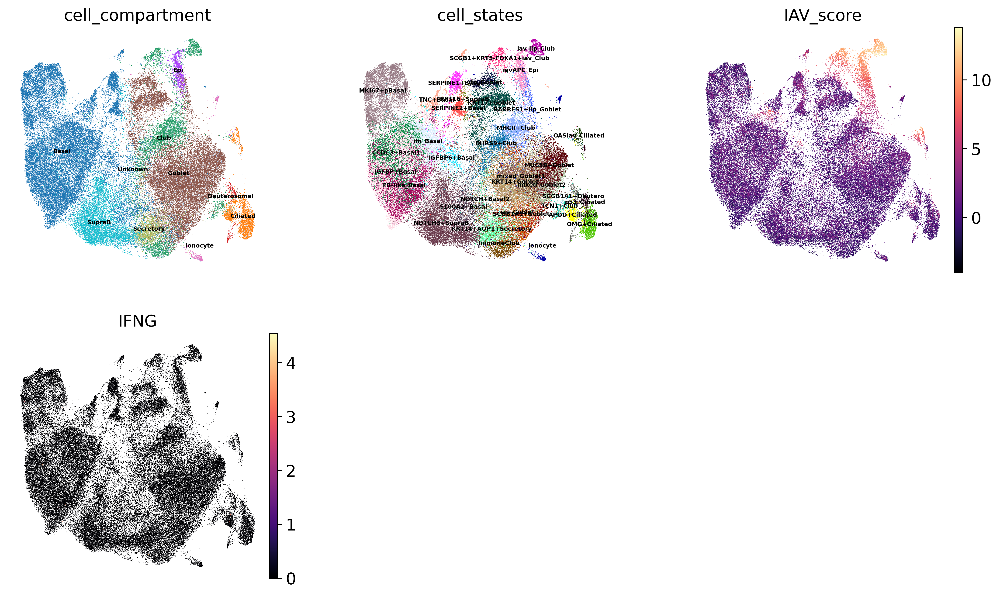

In [8]:
sc.pl.umap(adata_log, frameon = False, color = ['cell_compartment', 'cell_states', 'IAV_score', 'IFNG'], size = 1, legend_fontsize = 5, ncols = 3, legend_loc = 'on data')

/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


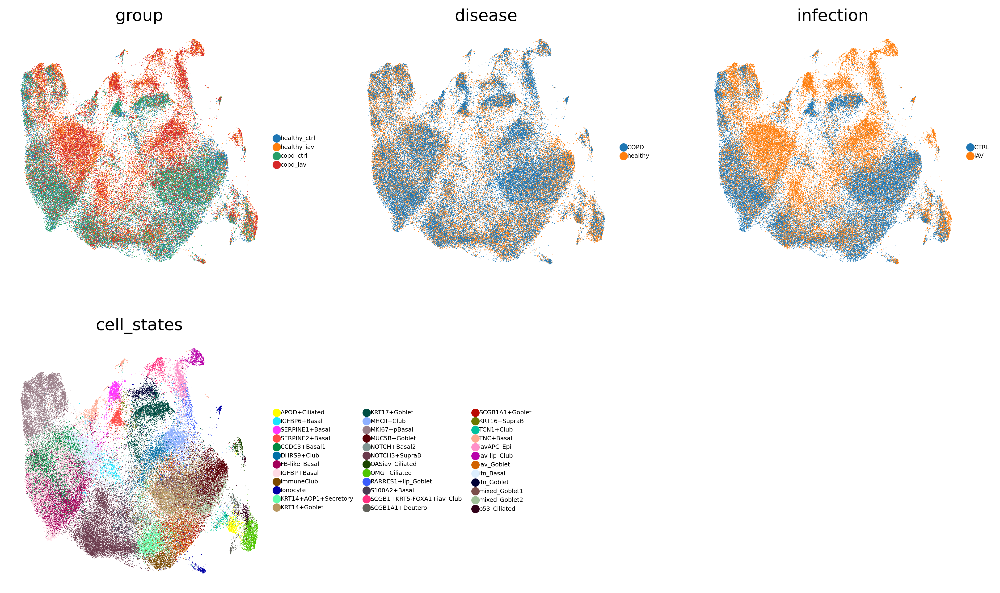

In [9]:
sc.pl.umap(adata_log, frameon = False, color = ['group', 'disease', 'infection', 'cell_states'], size = 1, legend_fontsize = 5, ncols = 3)

/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


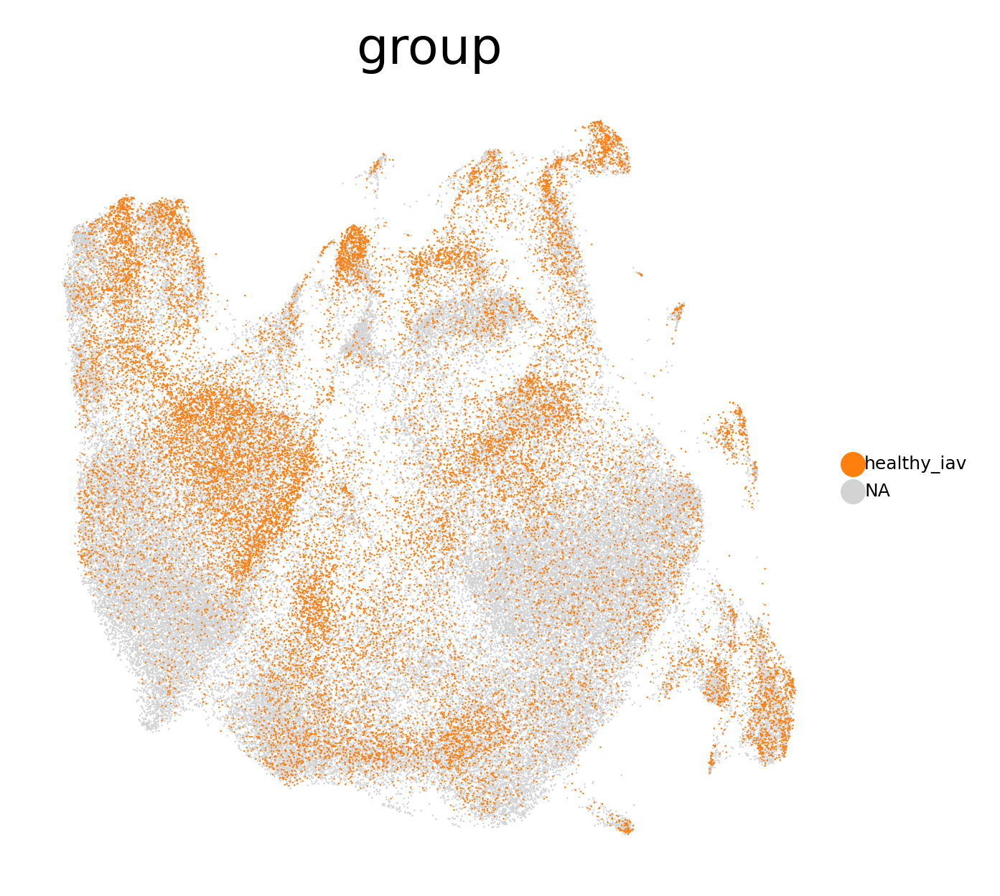

In [10]:
sc.pl.umap(adata_log, frameon = False, color = ['group'], groups = ['healthy_iav'], size = 1, legend_fontsize = 5, ncols = 3)

/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


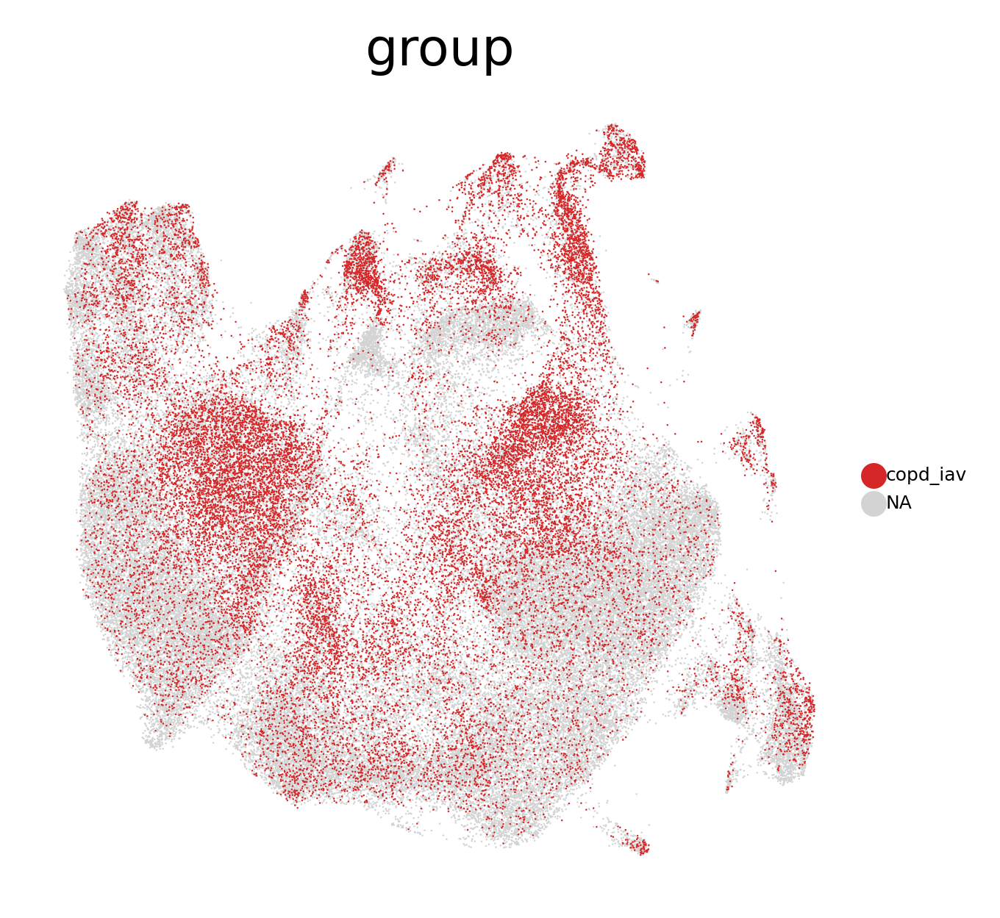

In [11]:
sc.pl.umap(adata_log, frameon = False, color = ['group'], groups = ['copd_iav'], size = 1, legend_fontsize = 5, ncols = 3)

### Visualise cannonical markers

In [12]:
literature_markers = ['ASCL1','KRT14','FOXA2','MUC5AC','AGER','SCGB1A1','SFTPC','HOPX','MUC5B','SPDEF','KRT4','TRPM5','DTNB','GNB3','SPIB','ETV1','DCLK1','IL25',
'LRMP','GNG13','NGF','SOX4','KCNMA1','TFCP2L1','ASCL3','HEPACAM2','CFTR','MALAT1','NREP','HES6','PSMD5','ALOX5AP','ASCL2','CHGA','NFATC1','RARRES2','ANK1','POU2F3',
'KRT13','CEACAM5','S100A4','CD36','FOXJ1','RTKN2','TMEM190','DEUP1','FOXN4','CDC20B','TP63','KRT5','KRT19','NOTCH3','MGP','SCGB3A1','BPIFB1','CYR61','IGFBP3',
'MSMB','GSTA2','LYPD2','PIP','PSCA','SERPINB3','IDO1','SERPINB4','NRARP','BCAM','MKI67','TOP2A','PTTG1','CENPF','STMN1','VIM','MYL9','TAGLN','CCDC3','DLK2','DST',
'TNC','CDH1','ATP12A','GPNMB','S100A8','RARRES1','AZGP1','KIT','KCNN3','ATP2A3']

hansbrolab_markers = ['SCGB1A1','BPIFB1','BPIFA1','SCGB3A1','MSMB','MUC5B','PIGR','SERPINA3','SLPI','AGR2','CAPN13','CXCL6','RARRES1','CYP2F1','XBP1','CXCL1','WFDC2',
'NR4A1','PRSS23','LYPD2','KRT13','UPK1B','IGFBP3','EPAS1','APOL1','TCN1','S100A9','DHRS9','FAM83A','GMNN','CRABP2','SPRR1B','MT1X','S100P','CLDN4','GSN','TF','INSR',
'NOTCH3','EGLN3','SLC3A2','PSAT1','FTH1','CLGN','GDF15','MTHFD2','SLC1A5','TMEM106B','STOM','SLC7A5','HSPD1','AKR1C2','HSPA9','NAMPT','KLHDC7B','ABLIM1',
'CDKN1A','HSD11B2','IFIT2','ISG15','IFIT3','IFIT1','IFITM1','MX1','S100P','SAA2','XAF1','MX2','IFI44L','IFI6','OAS2','OAS1','RSAD2','BST2','IFIH1','TXNIP','IFITM3','NT5C3A',
'TOP2A','TUBA1B','S100A2','MT2A','STMN1','KRT6A','HMGB2','MKI67','PCNA','PLP2','CAV1','RRM2','PRR11','TPX2','CKS2','SMC4','NUSAP1','SFN','FOXJ1','PSENEN',
'ZMYND10','TPPP3','TUBB4B','CDC20B','CCNO','PCM1','RSPH1','CCDC74A','KIF9','TUBA1A','ROPN1L','CAPS','CDK2AP2','PIFO','C1orf194','PLK4','PTGES3','TPPP3','SNTN',
'CAPS','TUBA1A','PIFO','RSPH1','C9orf24','C1orf194','TUBB4B','FOXJ1','CTXN1','CCDC170','PSENEN','ROPN1L','ENKUR','SRGAP3-AS2','LRRIQ1','ZMYND10',
'S100A2','KRT5','TINAGL1','LGALS1','MT2A','DST','CAV1','COL17A1','SFN','IGFBP2','ITGB1','S100A10','CCND2','CAVIN1','KRT15','IGFBP6','KRT6A','GPNMB','SH3BGRL3','SERPINE1',
'PMEPA1','LAMC2','KRT6A','KRT17','SLC7A5','LAMB3','VIM','SLC3A2','FSTL3','FLNA','CALD1','LAMA3','TPM1','G0S2','CAMK2N1','ITGB6','TAGLN','MAF']

In [49]:
adata_log_subset = adata_log[:, literature_markers]
dense_matrix = adata_log_subset.X.toarray()

row_linkage = linkage(dense_matrix, method = 'average', metric = 'euclidean')
col_linkage = linkage(dense_matrix.T, method = 'average', metric = 'euclidean')


In [50]:
unique_compartments = adata_log_subset.obs['cell_states'].unique()
colormap = dict(zip(unique_compartments, sns.color_palette("tab20", n_colors = len(unique_compartments))))

In [51]:
row_colors = [colormap[val] for val in adata_log_subset.obs['cell_states']]

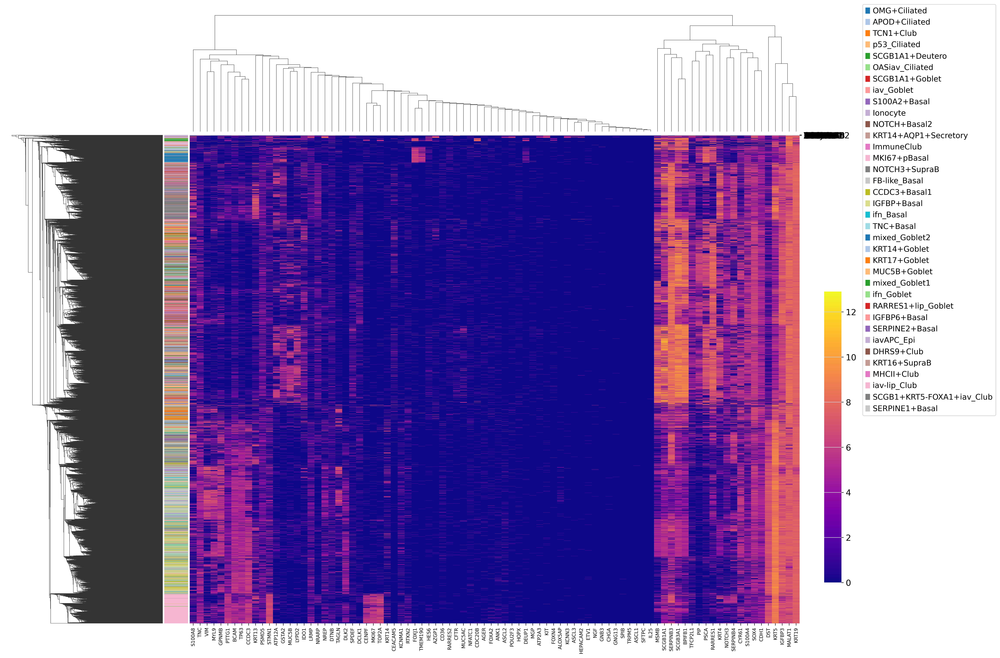

In [57]:
g = sns.clustermap(
    dense_matrix,
    row_linkage = row_linkage,
    col_linkage = col_linkage,
    row_cluster = True, 
    col_cluster = True, 
    cmap = 'plasma',
    figsize = (20, 15),
    row_colors = row_colors,
    yticklabels = adata_log_subset.var.index,
    xticklabels = True  
)

reordered_genes = adata_log_subset.var.index[g.dendrogram_col.reordered_ind]

g.ax_heatmap.set_xticklabels(reordered_genes, rotation = 90, fontsize = 8)

legend_patches = [mpatches.Patch(color = color, label = label) 
                  for label, color in colormap.items()]

g.fig.legend(handles = legend_patches, 
             bbox_to_anchor = (1, 1),  
             loc = 'upper left', 
             bbox_transform = g.fig.transFigure)  

g.ax_heatmap.xaxis.grid(False)

cbar = g.cax
cbar_width = 0.2 
cbar_width_ratios = [cbar_width, 1]
g.cax.set_position([0.96, 0.1, .02, .45]) 

plt.show()


In [58]:
from scipy.cluster.hierarchy import linkage

adata_log_subset = adata_log[:, hansbrolab_markers]
dense_matrix = adata_log_subset.X.toarray()

row_linkage = linkage(dense_matrix, method = 'average', metric = 'euclidean')
col_linkage = linkage(dense_matrix.T, method = 'average', metric = 'euclidean')


In [59]:
unique_compartments = adata_log_subset.obs['cell_states'].unique()
colormap = dict(zip(unique_compartments, sns.color_palette("tab20", n_colors=len(unique_compartments))))

In [60]:
row_colors = [colormap[val] for val in adata_log_subset.obs['cell_states']]

In [61]:
g = sns.clustermap(
    dense_matrix,
    row_linkage=row_linkage,
    col_linkage=col_linkage,
    row_cluster=True,  # showing the dendrogram
    col_cluster=True,  # showing the dendrogram
    cmap='plasma',
    figsize=(25, 15),
    row_colors=row_colors,
    yticklabels=adata_log_subset.var.index,
    xticklabels=True  # Initially set to true for correct sizing
)

# Get reordered gene names
reordered_genes = adata_log_subset.var.index[g.dendrogram_col.reordered_ind]

# Set reordered gene names as x-tick labels
g.ax_heatmap.set_xticklabels(reordered_genes, rotation=90, fontsize=8)

# Create a list of patches for the legend
legend_patches = [mpatches.Patch(color=color, label=label) 
                  for label, color in colormap.items()]

# Add the legend to the right of the figure
g.fig.legend(handles=legend_patches, 
             bbox_to_anchor=(1, 1),  # 1.05 moves the legend slightly to the right
             loc='upper left', 
             bbox_transform=g.fig.transFigure)  # Use figure coordinates

g.ax_heatmap.xaxis.grid(False)

# Adjust the width of the colorbar
cbar = g.cax
cbar_width = 0.2  # You can adjust this value to your preference
cbar_width_ratios = [cbar_width, 1]
g.cax.set_position([0.96, 0.1, .02, .45])  # Adjust the position and dimensions of the colorbar

plt.show()

### Visualise data covariates in UMAP

In [ ]:
sc.pl.umap(BrEpit_ALL, frameon = False, color = ['IAV_score', 'cell_states'], size = 3, legend_fontsize = 8, ncols = 3)

In [ ]:
sc.pl.umap(adata_log, frameon = False, color = ['MUC5B', 'cell_states', 'IAV_score'], size = 0.8, legend_fontsize = 9, ncols = 3, legend_loc = 'on data', layer = 'sqrt_norm')

### Visualise proportions of cell states per conditions

In [ ]:
df = adata_log.obs.groupby(['group', 'cell_states']).size().reset_index(name = 'counts')

grouped = df.groupby('group')['counts'].apply(lambda x: x / x.sum() * 100)
grouped = grouped.reset_index()

df['proportions'] = grouped['counts']
df['waffle_counts'] = (df['proportions'] * 10).astype(int)

In [ ]:
for group in df['group'].unique():
    temp_df = df[df['group'] == group]
    
    data = dict(zip(temp_df['cell_states'], temp_df['waffle_counts']))
    fig = plt.figure(
        FigureClass = Waffle, 
        rows = 8, 
        values = data, 
        title = {'label': f'Group {group}', 'loc': 'left'},
        labels = [f"{k} ({v}%)" for k, v in zip(temp_df['cell_states'], temp_df['proportions'].round(2))],
        #legend = {'loc': 'lower left', 'bbox_to_anchor': (0, -0.4), 'ncol': len(data), 'framealpha': 0},
        legend = {'loc': 'lower left', 'bbox_to_anchor': (0, -0.4), 'ncol': 12, 'framealpha': 0},
        figsize = (40, 4)
    )
    plt.show()

In [ ]:
data = pd.crosstab(adata_log.obs['group'], adata_log.obs['cell_states'])
#totals = data.sum(axis = 1)
#percent = data.div(totals, axis = 0).mul(100).round(2)

ax1 = data.plot.barh(stacked = True, edgecolor = 'none', zorder = 3, figsize = (16,8), fontsize = 10, grid = False, width = 0.6)
horiz_offset = 1.0
vert_offset = 1.0
ax1.legend(bbox_to_anchor = (horiz_offset, vert_offset), ncol = 1)

for c in ax1.containers:
    
    # custom label calculates percent and add an empty string so 0 value bars don't have a number
    labels = [f'{w:0.2f}' if (w := v.get_width()) > 0 else '' for v in c]
    
    # add annotations
    ax1.bar_label(c, labels = labels, label_type = 'center', padding = 1, color = 'black', rotation = 270, fontsize = 6)

### Visualise marker genes

In [ ]:
adata_log.obs['cell_states'].cat.categories

In [ ]:
markers = ['SCGB1A1','SCGB3A1','KRT5','MUC5B','KRT17','SFTPC','CD74','MUC5AC','TP63','FOXJ1']
sc.pl.stacked_violin(adata_log, markers, groupby = 'cell_states', dendrogram = True, cmap = 'magma', layer = 'sqrt_norm')

In [ ]:
sc.pl.dotplot(adata_log, markers, groupby = 'cell_states', layer = 'sqrt_norm', cmap = 'magma')

In [ ]:
sc.pl.umap(adata_log, frameon = False, color = ['leiden_states', 'IAV_score', 'KRT5', 'KRT17', 'ACTB', 'SCGB1A1'], size = 0.5, legend_fontsize = 5, ncols = 3, legend_loc = 'on data', layer = 'sqrt_norm', cmap = 'magma')

In [ ]:
markers = ['SERPINE1', 'SERPINE2', 'PMEPA1', 'AMIGO2', 'LGALS1', 'MYL9', 'DKK3', 'MMP2']
sc.pl.stacked_violin(adata_log, markers, groupby = 'group', dendrogram = True, cmap = 'RdPu')

In [ ]:
markers = ['TWIST1', 'FOXC2', 'SNAI1', 'VIM', 'FGFR1']
sc.pl.stacked_violin(adata_log, markers, groupby = 'group', dendrogram = True, cmap = 'RdPu')

In [ ]:
markers = ['TWIST1', 'FOXC2', 'SNAI1', 'VIM', 'FGFR1']
sc.pl.stacked_violin(adata_log, markers, groupby = 'disease', dendrogram = True, cmap = 'RdPu')

In [ ]:
markers = ['TWIST1', 'FOXC2', 'SNAI1', 'VIM', 'FGFR1']
sc.pl.stacked_violin(adata_log, markers, groupby = 'infection', dendrogram = True, cmap = 'RdPu')

In [ ]:
markers = ['TWIST1', 'FOXC2', 'SNAI1', 'VIM', 'FGFR1', 'FN1']
sc.pl.stacked_violin(adata_log, markers, groupby = 'leiden_states', dendrogram = True, cmap = 'RdPu')

### Calculate expression scores

- KEGG Influenza A signature

In [ ]:
kegg = KEGG()
pathway = kegg.get('hsa05164')
genes = kegg.parse(pathway)

gene_list = [desc.split(';')[0] for desc in genes['GENE'].values()]
gene_list

In [ ]:
sc.tl.score_genes(BrEpit_ALL, gene_list, score_name = 'KEGG-IAV_Score', use_raw = False)
adata_log.obs['KEGG-IAV_Score'] = BrEpit_ALL.obs['KEGG-IAV_Score'].copy()
sc.pl.umap(adata_log, frameon = False, color = ['cell_states', 'IAV_score', 'KEGG-IAV_Score'], size = 0.5, legend_fontsize = 5, ncols = 3, legend_loc = 'on data', layer = 'sqrt_norm', cmap = 'magma')

- KEGG Interferon alpha

In [ ]:
kegg = KEGG()
pathway = kegg.get('hsa04630')
genes = kegg.parse(pathway)

gene_list = [desc.split(';')[0] for desc in genes['GENE'].values()]
gene_list

In [ ]:
sc.tl.score_genes(BrEpit_ALL, gene_list, score_name = 'IFNab_Score', use_raw = False)
adata_log.obs['IFNab_Score'] = BrEpit_ALL.obs['IFNab_Score'].copy()
sc.pl.umap(adata_log, frameon = False, color = ['leiden_states', 'IAV_score', 'KEGG-IAV_Score', 'IFNab_Score'], size = 0.5, legend_fontsize = 5, ncols = 3, legend_loc = 'on data', layer = 'sqrt_norm', cmap = 'magma')

- KEGG interferon gamma

In [ ]:
kegg = KEGG()
pathway = kegg.get('hsa04622')
genes = kegg.parse(pathway)

gene_list = [desc.split(';')[0] for desc in genes['GENE'].values()]
gene_list

In [ ]:
sc.tl.score_genes(BrEpit_ALL, gene_list, score_name = 'IFNg_Score', use_raw = False)
adata_log.obs['IFNg_Score'] = BrEpit_ALL.obs['IFNg_Score'].copy()
sc.pl.umap(adata_log, frameon = False, color = ['leiden_states', 'IAV_score', 'KEGG-IAV_Score', 'IFNab_Score', 'IFNg_Score'], size = 0.5, legend_fontsize = 5, ncols = 3, legend_loc = 'on data', layer = 'sqrt_norm', cmap = 'magma')

- KEGG IL-1

In [ ]:
kegg = KEGG()
pathway = kegg.get('hsa04668')
genes = kegg.parse(pathway)

gene_list = [desc.split(';')[0] for desc in genes['GENE'].values()]
gene_list

In [ ]:
sc.tl.score_genes(BrEpit_ALL, gene_list, score_name = 'IL1_Score', use_raw = False)
adata_log.obs['IL1_Score'] = BrEpit_ALL.obs['IL1_Score'].copy()
sc.pl.umap(adata_log, frameon = False, color = ['leiden_states', 'IAV_score', 'KEGG-IAV_Score', 'IFNab_Score', 'IFNg_Score', 'IL1_Score'], size = 0.5, legend_fontsize = 5, ncols = 3, legend_loc = 'on data', layer = 'sqrt_norm', cmap = 'magma')

### Calculate cluster-specific marker genes using _Wilcoxon's Rank Sum Test_

In [ ]:
sc.tl.rank_genes_groups(adata_log, 'leiden_states', method = 'wilcoxon', n_genes = 100, use_raw = False)
result = adata_log.uns['rank_genes_groups']
groups = result['names'].dtype.names
wilcox_markers = pd.DataFrame(
{group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names','logfoldchanges', 'pvals_adj']})
wilcox_markers.head(10)

### Visualise marker genes

In [ ]:
sc.pl.rank_genes_groups_dotplot(adata_log, n_genes = 5, cmap = 'magma')

### Calculate marker genes per condition

- Split dataset by condition

In [ ]:
healthy_ctrl_log = adata_log[adata_log.obs['group'].isin(['healthy_ctrl'])]
healthy_ctrl_log 

In [ ]:
sc.tl.rank_genes_groups(healthy_ctrl_log, 'leiden_states', method = 'wilcoxon', n_genes = healthy_ctrl_log.shape[1], use_raw = False)
result = healthy_ctrl_log.uns['rank_genes_groups']
groups = result['names'].dtype.names
wilcox_markers = pd.DataFrame(
{group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names','logfoldchanges', 'pvals_adj']})
wilcox_markers.head(10)

In [ ]:
sc.pl.rank_genes_groups_dotplot(healthy_ctrl_log, n_genes = 5, values_to_plot = 'scores', cmap = 'coolwarm')

In [ ]:
sc.pl.rank_genes_groups_dotplot(healthy_ctrl_log, n_genes = 5, values_to_plot = 'logfoldchanges', cmap = 'coolwarm')

In [ ]:
healthy_iav_log = adata_log[adata_log.obs['group'].isin(['healthy_iav'])]
healthy_iav_log 

In [ ]:
sc.tl.rank_genes_groups(healthy_iav_log, 'leiden_states', method = 'wilcoxon', n_genes = healthy_iav_log.shape[1], use_raw = False)
result = healthy_iav_log.uns['rank_genes_groups']
groups = result['names'].dtype.names
wilcox_markers = pd.DataFrame(
{group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names','logfoldchanges', 'pvals_adj']})
wilcox_markers.head(10)

In [ ]:
sc.pl.rank_genes_groups_dotplot(healthy_iav_log, n_genes = 5, values_to_plot = 'scores', cmap = 'coolwarm')

In [ ]:
sc.pl.rank_genes_groups_dotplot(healthy_iav_log, n_genes = 5, values_to_plot = 'logfoldchanges', cmap = 'coolwarm')

In [ ]:
copd_ctrl_log = adata_log[adata_log.obs['group'].isin(['copd_ctrl'])]
copd_ctrl_log 

In [ ]:
sc.tl.rank_genes_groups(copd_ctrl_log, 'leiden_states', method = 'wilcoxon', n_genes = healthy_iav_log.shape[1], use_raw = False)
result = copd_ctrl_log.uns['rank_genes_groups']
groups = result['names'].dtype.names
wilcox_markers = pd.DataFrame(
{group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names','logfoldchanges', 'pvals_adj']})
wilcox_markers.head(10)

In [ ]:
sc.pl.rank_genes_groups_dotplot(copd_ctrl_log, n_genes = 5, values_to_plot = 'scores', cmap = 'coolwarm')

In [ ]:
sc.pl.rank_genes_groups_dotplot(copd_ctrl_log, n_genes = 5, values_to_plot = 'logfoldchanges', cmap = 'coolwarm')

In [ ]:
copd_iav_log = adata_log[adata_log.obs['group'].isin(['copd_iav'])]
copd_iav_log 

In [ ]:
sc.tl.rank_genes_groups(copd_iav_log, 'leiden_states', method = 'wilcoxon', n_genes = healthy_iav_log.shape[1], use_raw = False)
result = copd_iav_log.uns['rank_genes_groups']
groups = result['names'].dtype.names
wilcox_markers = pd.DataFrame(
{group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names','logfoldchanges', 'pvals_adj']})
wilcox_markers.head(10)

In [ ]:
sc.pl.rank_genes_groups_dotplot(copd_iav_log, n_genes = 5, values_to_plot = 'scores', cmap = 'coolwarm')

In [ ]:
sc.pl.rank_genes_groups_dotplot(copd_iav_log, n_genes = 5, values_to_plot = 'logfoldchanges', cmap = 'coolwarm')

### Export annotated object

In [ ]:
BrEpit_ALL

In [ ]:
sc.pl.umap(BrEpit_ALL, frameon = False, color = ['leiden_states', 'STEAP4', 'CEP55', 'FOXJ1', 'PIGR', 'SERPINE2', 'ADM2', 'WNT10A'], size = 1, legend_fontsize = 5, ncols = 4, legend_loc = 'on data')